In [0]:
from pyspark.sql.functions import *
from pyspark.sql.types import *
import zipfile
import shutil

# Here I had declared a function to process a ZIP file and then loaded the CSV into a DataFrame
def process_zip_file(dbfs_zip_path, local_zip_path, extract_dir, dbfs_extracted_dir, csv_file_name):
    # Copied the ZIP file to the local path
    dbutils.fs.cp(dbfs_zip_path, "file:" + local_zip_path)

    # Extracted ZIP file locally
    with zipfile.ZipFile(local_zip_path, 'r') as zf:
        # Printed the contents of the ZIP file to verify its structure
        print(f"Contents of {local_zip_path}:")
        print(zf.namelist())
        # Extracting all files from the ZIP archive to the specified directory
        zf.extractall(extract_dir)
        print(f"Files extracted to: {extract_dir}")

    # Then Moved extracted files back to DBFS
    for file_name in zf.namelist():
        local_file_path = f"{extract_dir}/{file_name}"
        dbfs_file_path = f"{dbfs_extracted_dir}/{file_name}"
        # Copying the extracted file from the local system to DBFS
        dbutils.fs.cp(f"file:{local_file_path}", dbfs_file_path)
        print(f"Moved {local_file_path} to {dbfs_file_path}")

    # Finally Loaded the CSV file into a Spark DataFrame
    csv_file_path = f"{dbfs_extracted_dir}/{csv_file_name}"
    df = spark.read.csv(csv_file_path, header=True, inferSchema=True)
    return df

# (I have four excel files)
# Defining the file paths and configurations for processing each dataset
datasets = {
    "df_daily_rent_detail": {
        # DBFS path to the ZIP file
        "dbfs_zip_path": "dbfs:/FileStore/tables/daily_rent_detail.zip",
        # Local path to temporarily store the ZIP file
        "local_zip_path": "/tmp/daily_rent_detail.zip",
        # CSV file to be loaded from the ZIP
        "csv_file_name": "daily_rent_detail.csv"
    },
    "df_station_list": {
        "dbfs_zip_path": "dbfs:/FileStore/tables/station_list.zip",
        "local_zip_path": "/tmp/station_list.zip",
        "csv_file_name": "station_list.csv"
    },
    "df_usage_frequency": {
        "dbfs_zip_path": "dbfs:/FileStore/tables/usage_frequency.zip",
        "local_zip_path": "/tmp/usage_frequency.zip",
        "csv_file_name": "usage_frequency.csv"
    },
    "df_weather": {
        "dbfs_zip_path": "dbfs:/FileStore/tables/weather.zip",
        "local_zip_path": "/tmp/weather.zip",
        "csv_file_name": "weather.csv"
    }
}

# Defining general paths for extracting files locally and storing them back in DBFS
extract_dir = "/tmp/extracted_files"  # Local directory for extracting files
dbfs_extracted_dir = "dbfs:/FileStore/tables/extracted_files" # DBFS directory to store extracted files

# Process each dataset and store the DataFrames in variables
df_daily_rent_detail = process_zip_file(**datasets["df_daily_rent_detail"], extract_dir=extract_dir, dbfs_extracted_dir=dbfs_extracted_dir)
df_station_list = process_zip_file(**datasets["df_station_list"], extract_dir=extract_dir, dbfs_extracted_dir=dbfs_extracted_dir)
df_usage_frequency = process_zip_file(**datasets["df_usage_frequency"], extract_dir=extract_dir, dbfs_extracted_dir=dbfs_extracted_dir)
df_weather = process_zip_file(**datasets["df_weather"], extract_dir=extract_dir, dbfs_extracted_dir=dbfs_extracted_dir)

# Now showing the data of each files using .display()
df_daily_rent_detail.display()
df_station_list.display()
df_usage_frequency.orderBy(desc("date")).display()
df_weather.display()


# **Cleaning the Data**

Dropping the unecessary columns in dataframe **daily_rent_detail** 

In [0]:
# Used .drop() to delete columns
df_daily_rent_detail = df_daily_rent_detail.drop("start_lat", "start_lng", "end_lat", "end_lng", "start_station_name", "end_station_name")

# Used .dropDuplicates() to remove duplicates 
df_daily_rent_detail = df_daily_rent_detail.dropDuplicates()
df_daily_rent_detail.display(10)

ride_id,rideable_type,started_at,ended_at,start_station_id,end_station_id,member_casual
86FABCF4BB8F686C,docked_bike,2020-05-22T18:53:02.000+0000,2020-05-22T19:00:32.000+0000,31260,31214.0,casual
A10F707501617B32,docked_bike,2020-05-21T13:53:00.000+0000,2020-05-21T14:04:35.000+0000,31600,31241.0,member
7E33FE12035CE9C9,docked_bike,2020-05-19T10:13:31.000+0000,2020-05-19T10:15:16.000+0000,31313,31300.0,member
2C45217EC76FC974,docked_bike,2020-05-23T15:41:52.000+0000,2020-05-23T16:21:22.000+0000,31041,31064.0,casual
BE51A2A75B1E68DC,docked_bike,2020-05-21T18:06:46.000+0000,2020-05-21T18:56:29.000+0000,31286,31615.0,casual
33BFA8880689B4BB,docked_bike,2020-05-07T10:26:34.000+0000,2020-05-07T10:33:11.000+0000,31294,31108.0,member
C74D55BC5E7AFD3B,docked_bike,2020-05-10T13:03:59.000+0000,2020-05-10T14:09:04.000+0000,31108,31108.0,casual
B0568C02C9C5A9D0,docked_bike,2020-05-16T02:02:49.000+0000,2020-05-16T02:16:57.000+0000,31246,31246.0,casual
99BEEFB822B66A3F,docked_bike,2020-05-05T12:14:54.000+0000,2020-05-05T12:31:34.000+0000,31108,31108.0,casual
C21A26B9A61A5973,docked_bike,2020-05-16T11:22:40.000+0000,2020-05-16T12:00:01.000+0000,31113,31113.0,casual


Checking the null values in dataframe  **df_daily_rent_detail**

In [0]:
# Made use of .isNull() to check null values in each column
df = df_daily_rent_detail.where(
    (col("ride_id").isNull()) |
    (col("rideable_type").isNull()) |
    (col("start_station_id").isNull()) |
    (col("end_station_id").isNull()) |
    (col("member_casual").isNull())
  
)

df.display()

ride_id,rideable_type,started_at,ended_at,start_station_id,end_station_id,member_casual
826A64F6C3E96505,docked_bike,2020-05-17T18:04:22.000+0000,2020-05-18T19:04:10.000+0000,31314,null,casual
F8C046EBF6A0DF3F,docked_bike,2020-05-07T18:21:30.000+0000,2020-05-07T21:41:06.000+0000,31109,null,member
1C985250321E94BC,docked_bike,2020-05-12T08:09:17.000+0000,2020-05-12T11:04:35.000+0000,31264,null,casual
B4A1D2DA9FCB9BAB,docked_bike,2020-05-28T13:37:56.000+0000,2020-05-28T14:08:42.000+0000,31622,null,casual
879A1E73EA558728,docked_bike,2020-06-20T12:23:27.000+0000,2020-06-20T13:01:06.000+0000,31239.0,null,member
F9E15A5B3D7BD602,docked_bike,2020-06-01T17:56:26.000+0000,2020-06-02T18:56:19.000+0000,31638.0,null,casual
373C9021AEF4ACBB,docked_bike,2020-06-26T13:53:49.000+0000,2020-06-26T14:10:20.000+0000,31287.0,null,casual
58449599D2993D28,docked_bike,2020-07-23T19:45:19.000+0000,2020-07-24T10:39:46.000+0000,31071.0,null,casual
99AE19E13BC65329,electric_bike,2020-07-25T10:45:28.000+0000,2020-07-25T11:29:58.000+0000,31102.0,null,casual
4482660294A454FF,electric_bike,2020-07-31T15:26:09.000+0000,2020-07-31T15:29:43.000+0000,31117.0,null,casual


Replacing the null values with 0 in dataframe df_daily_rent_detail

In [0]:
# Replacing null values with 0 in two columns Why?

columns_replace = ["start_station_id", "end_station_id"]
df_daily_rent_detail = df_daily_rent_detail.fillna(0, subset=columns_replace).cache()

# Show the updated DataFrame
df_daily_rent_detail.display()

ride_id,rideable_type,started_at,ended_at,start_station_id,end_station_id,member_casual
86FABCF4BB8F686C,docked_bike,2020-05-22T18:53:02.000+0000,2020-05-22T19:00:32.000+0000,31260,31214.0,casual
A10F707501617B32,docked_bike,2020-05-21T13:53:00.000+0000,2020-05-21T14:04:35.000+0000,31600,31241.0,member
7E33FE12035CE9C9,docked_bike,2020-05-19T10:13:31.000+0000,2020-05-19T10:15:16.000+0000,31313,31300.0,member
2C45217EC76FC974,docked_bike,2020-05-23T15:41:52.000+0000,2020-05-23T16:21:22.000+0000,31041,31064.0,casual
BE51A2A75B1E68DC,docked_bike,2020-05-21T18:06:46.000+0000,2020-05-21T18:56:29.000+0000,31286,31615.0,casual
33BFA8880689B4BB,docked_bike,2020-05-07T10:26:34.000+0000,2020-05-07T10:33:11.000+0000,31294,31108.0,member
C74D55BC5E7AFD3B,docked_bike,2020-05-10T13:03:59.000+0000,2020-05-10T14:09:04.000+0000,31108,31108.0,casual
B0568C02C9C5A9D0,docked_bike,2020-05-16T02:02:49.000+0000,2020-05-16T02:16:57.000+0000,31246,31246.0,casual
99BEEFB822B66A3F,docked_bike,2020-05-05T12:14:54.000+0000,2020-05-05T12:31:34.000+0000,31108,31108.0,casual
C21A26B9A61A5973,docked_bike,2020-05-16T11:22:40.000+0000,2020-05-16T12:00:01.000+0000,31113,31113.0,casual


Dropping the duplicates and checking the null values in dataframe **df_station_list** 

In [0]:
#Checked the null values in entire table 
df = df_station_list.where(
    (col("station_id").isNull()) |
    (col("station_name").isNull()) 
)
df.display() # There were no null values

#Dropping duplicates
df_station_list = df_station_list.dropDuplicates().cache()
df_station_list.display()

Dropping the unnecessary columns, checking null values and dropping duplicates in dataframe **df_usage_frequency** 


In [0]:
#Checked the null values in df_usage_frequency
df = df_usage_frequency.where(
    (col("station_name").isNull()) |
    (col("pickup_counts").isNull()) |
    (col("dropoff_counts").isNull())
)
df.display() # Hence No null values were returned

#Dropping the duplicates
df_usage_frequency = df_usage_frequency.dropDuplicates().cache()

df_usage_frequency.display()

Checking null values, removing duplicates in dataframe **df_weather** and caching it

In [0]:
# df_weather = df_weather.drop("tempmax", "tempmin",  "preciptype", "snowdepth", "feelslikemax", "feelslikemin", "windgust", "winddir", "sealevelpressure",   "severerisk",  "tempmax", "tempmin", "precipcover", "name", "station_name")


#Checked the null values in df_weather 
df = df_weather.where(
    (col("temp").isNull()) |
    (col("humidity").isNull()) |
    (col("precip").isNull()) |
    (col("precipprob").isNull()) |
    (col("snow").isNull()) |
    (col("windspeed").isNull()) |
    (col("icon").isNull()) |
    (col("solarenergy").isNull()) |
    (col("cloudcover").isNull()) |
    (col("moonphase").isNull()) |
    (col("solarenergy").isNull()) 
)
df.display() # For this no null values were detected

#Dropping the duplicates
df_weather = df_weather.drop_duplicates().cache() 

df_weather.display(5)


# **EDA**

Performing EDA on every individual Files (4 files) <br>
Just to give idea how does the data looks like

Overall Number of times the bike has been picked?

In [0]:
# Making using of .count() to count pickup_counts

pickup_counts = df_usage_frequency.select("pickup_counts").count()
print(f"Number of pickup counts: {pickup_counts}")


Number of pickup counts: 873318


How many type of bikes are there?


In [0]:
# Group the daily rent details dataset by the column "rideable_type" then we count the number of occurrences for each bike type

df_grouped = df_daily_rent_detail.groupBy(col("rideable_type").alias("Bike_Types")) \
                                 .agg(count("rideable_type").alias("Number_Of_ Bikes"))


df_grouped.show(80)

How many people are member and casual

In [0]:
# Grouping the daily rent details dataset by the column member_casual then we count the number of occurrences for each member types

df_grouped = df_daily_rent_detail.groupBy(col("member_casual").alias("People")) \
                                 .agg(count("member_casual").alias("No_Of_People"))


df_grouped.show(80)

How many casual or member has picked each category of bike?

In [0]:
# Counting all records for each group and rename to "No_Of_People"

df_grouped = df_daily_rent_detail.groupBy("rideable_type", "member_casual") \
                                 .agg(count("*").alias("No_Of_People")) 
df_grouped.display()

Counting pickup counts based on the number of unique stations

In [0]:
# Counting all records for each station and renaming it to pickup_counts

df_grouped = df_usage_frequency.groupBy("station_name").agg(count("*").alias("pickup_counts")).orderBy(desc("pickup_counts"))
df_grouped.show(80)

Counting pickup counts based on the number of months and years

In [0]:
# Group the usage frequency dataset by station_name to calculate the total pickups for each station

df_usage_frequency = df_usage_frequency.withColumn("year", year("date")) \
                                       

# Here I wanted to display pickup counts based on the recent years 

df_grouped_mon_yrs = df_usage_frequency.groupBy("year") \
                     .agg(max("pickup_counts").alias("pickup_counts")) \
                     .orderBy(desc("year"))


df_grouped_mon_yrs.show()

+----+-------------+
|year|pickup_counts|
+----+-------------+
|2024|          375|
|2023|          444|
|2022|          377|
|2021|          357|
|2020|          439|
+----+-------------+



Top 3 Months in a particular year where pickup counts were more <br>
Here I made use of sql window functions such as partition by, over, row_number, rank 


In [0]:
# The process is first to extract month and year then assigning rank based on the year, month and then year, adding a new column rank based on the year, month and then year and finally using filter to limit only 3 months in a particular year

from pyspark.sql.window import Window

# Adding Year and Month Columns
df_usage_frequency = df_usage_frequency.withColumn("year", year("date")) \
                                       .withColumn("month", month("date"))


# I had defined window specifications [Partition by]
window_by_year_month = Window.partitionBy("year", "month").orderBy(desc("pickup_counts"))
window_by_year = Window.partitionBy("year").orderBy(desc("pickup_counts"))


# Used SQL Window functions [row_number(), over()] and adding rank column 
df_with_rank = df_usage_frequency.withColumn("rank_within_month", row_number().over 
                                            (window_by_year_month)) \
                                            .filter(col("rank_within_month") == 1) \
                                            .withColumn("rank", row_number().over(window_by_year))


# I wanted Top 3 pickup counts in a month in single year. Filtered the rows per year
df_top_two_distinct = df_with_rank.filter(col("rank") <= 3) \
                                  .select("year", "month", "pickup_counts") \
                                  .orderBy(desc("year"), "rank")


df_top_two_distinct.show()




+----+-----+-------------+
|year|month|pickup_counts|
+----+-----+-------------+
|2024|    3|          375|
|2024|    5|          260|
|2024|    6|          249|
|2023|    3|          444|
|2023|    7|          270|
|2023|    6|          257|
|2022|    7|          377|
|2022|    3|          293|
|2022|    5|          283|
|2021|    4|          357|
|2021|    7|          349|
|2021|    5|          281|
|2020|    6|          439|
|2020|    9|          253|
|2020|   10|          243|
+----+-----+-------------+



### After Performing EDA <br> Its time to Join 2 DataFrames <br> Check again whether any missing data is there and <br> perform EDA on the Join Dataframe 

Combine dataframe **df_usage_frequency** and **df_weather**
Our new dataframe is df_merged

In [0]:
# Rename the datetime column in the weather dataset that is df_weather to date

df_weather = df_weather.withColumnRenamed("datetime", "date")
df_weather = df_weather.withColumn("date", to_date("date", "yyyy-MM-dd"))

# I converted date to the same format in df_usage_frequency
df_usage_frequency = df_usage_frequency.withColumn("date", to_date("date", "yyyy-MM-dd"))

In [0]:
# Merging the usage frequency dataset and the weather dataset on the date column
# we'll use inner join

df_merged = df_usage_frequency.join(
    df_weather,  
    on=["date"],  
    how="inner"   
)

df_merged = df_merged.drop("feelslike", "feelslikemin", "feelslikemax", "preciptype", "snowdepth", "windgust", "winddir", "sealevelpressure", "severerisk", "name", "sunrise", "sunset", "conditions", "description", "icon", "stations", "dew", "solarradiation", "tempmax", "tempmin", "precipcover", "station_name").cache()

# Show the updated DataFrame
df_merged.display()

After Joining we again check for confirmation if there are any null values

In [0]:
# Filtering rows where pickup_counts is null and counting them

missing_pickup_counts = df_merged.filter(col("pickup_counts").isNull()).count()
print(f"Number of missing values in 'pickup_counts': {missing_pickup_counts}")

Number of missing values in 'pickup_counts': 0


In [0]:
# Checking for duplicate rows by grouping all columns and using filter to see duplicated rows count > 1

duplicate_rows = (
    df_merged.groupBy(df_merged.columns)
    .count()
    .filter("count > 1")  
)

# Show duplicate rows, if any
duplicate_rows.display()


date,pickup_counts,dropoff_counts,year,month,temp,humidity,precip,precipprob,snow,windspeed,cloudcover,visibility,solarenergy,uvindex,moonphase,count
2020-07-09,1,0.0,2020,7,27.9,71.8,0.0,0,0.0,17.5,47.4,15.9,6.0,4,0.64,16
2021-02-04,3,1.0,2021,2,3.6,39.2,0.0,0,0.0,26.5,38.3,16.0,9.0,5,0.75,7
2021-02-07,2,0.0,2021,2,3.3,70.5,12.488,100,2.2,24.7,78.4,13.5,3.2,3,0.85,16
2021-02-07,2,2.0,2021,2,3.3,70.5,12.488,100,2.2,24.7,78.4,13.5,3.2,3,0.85,13
2021-02-13,1,0.0,2021,2,-1.1,75.8,10.642,100,0.0,21.2,99.8,12.1,1.3,1,0.06,42
2022-03-18,3,4.0,2022,3,14.7,77.9,0.0,0,0.0,25.6,63.2,9.2,12.7,7,0.5,5
2022-04-10,1,0.0,2022,4,8.7,47.9,0.0,0,0.0,36.4,56.2,16.0,7.7,5,0.3,21
2022-04-27,6,6.0,2022,4,12.5,39.4,0.0,0,0.0,33.9,53.4,16.0,8.3,5,0.89,3
2022-05-02,6,5.0,2022,5,19.1,60.8,0.0,0,0.0,17.6,47.4,16.0,9.7,8,0.06,6
2022-09-03,2,1.0,2022,9,26.0,66.5,0.0,0,0.0,16.4,72.1,16.0,14.1,8,0.25,18


In [0]:
# Removing duplicate rows based on all columns
df_merged_cleaned = df_merged.dropDuplicates()

df_merged_cleaned.display()

In [0]:
def remove_outliers(df, columns):
    for col in columns:
        # Calculate Q1, Q3, and IQR
        q1 = df.approxQuantile(col, [0.25], 0.01)[0]
        q3 = df.approxQuantile(col, [0.75], 0.01)[0]
        iqr = q3 - q1
        
        # Define lower and upper bounds
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr
        
        # Filter rows within bounds
        df = df.filter((F.col(col) >= lower_bound) & (F.col(col) <= upper_bound))
    
    return df

# List of numerical columns in the dataset
numerical_columns = ["pickup_counts", "dropoff_counts", "temp", "humidity", "precip", "precipprob", "snow", "windspeed", "cloudcover", "visibility", "solarenergy", "uvindex"]

# Removing outliers
cleanedDF = remove_outliers(df_merged_cleaned, numerical_columns)
cleanedDF.show()

Correlations between pickup counts and weather conditions on the merge data 
<br>
[Dataframe: **df_usage_frequency** and **df_weather**]

Now df_merged will be our final and new dataframe for performing actual EDA

In [0]:
cleanedDF.describe(["pickup_counts", "dropoff_counts",  "temp",  "humidity", "precip",  "precipprob",  "snow",  "windspeed","cloudcover", "visibility", "solarenergy", "uvindex", "moonphase"]).display()

# Computing correlations between weather conditions and pickup counts using this df_merged.stat.corr 

correlations = [
    ("Temperature", cleanedDF.stat.corr("temp", "pickup_counts")),
    ("Precipitation", cleanedDF.stat.corr("precip", "pickup_counts")),
    ("Precipitation-Prob", cleanedDF.stat.corr("precipprob", "pickup_counts")),
    ("Dropoff_counts", cleanedDF.stat.corr("dropoff_counts", "pickup_counts")),
    ("Humidity", cleanedDF.stat.corr("humidity", "pickup_counts")),
    ("Wind Speed", cleanedDF.stat.corr("windspeed", "pickup_counts")),
    ("Snow", cleanedDF.stat.corr("snow", "pickup_counts")),
    ("Cloudcover", cleanedDF.stat.corr("cloudcover", "pickup_counts")),
    ("Visibility", cleanedDF.stat.corr("visibility", "pickup_counts")),
    ("Solarenergy", cleanedDF.stat.corr("solarenergy", "pickup_counts")),
    ("Uvindex", cleanedDF.stat.corr("uvindex", "pickup_counts")),
    ("Moonphase", cleanedDF.stat.corr("moonphase", "pickup_counts"))

]

# Displaying correlations
for condition, correlation in correlations:
    print(f"Correlation between {condition} and pickup counts: {correlation}")


**Descriptive Statistics**

In [0]:
from pyspark.sql.functions import skewness

# The target column pickup_counts is excluded to focus on the features.
# Here we get only numeric columns 
numeric_columns = [c for c, t in cleanedDF.dtypes if t in ('int', 'bigint', 'float', 'double') and c != "pickup_counts"]

# Calculating skewness for numeric columns
skewness_df = cleanedDF.select(
    *[skewness(c).alias(f"{c}_skewness") for c in numeric_columns]
)
skewness_df.display()


**Univariate Analysis**

In [0]:
# Count null or missing values in each column
null_counts = cleanedDF.select([count(when(col(c).isNull(), c)).alias(c) for c in df_merged.columns])
null_counts.show()

+----+-------------+--------------+----+-----+----+--------+------+----------+----+---------+----------+----------+-----------+-------+---------+
|date|pickup_counts|dropoff_counts|year|month|temp|humidity|precip|precipprob|snow|windspeed|cloudcover|visibility|solarenergy|uvindex|moonphase|
+----+-------------+--------------+----+-----+----+--------+------+----------+----+---------+----------+----------+-----------+-------+---------+
|   0|            0|             0|   0|    0|   0|       0|     0|         0|   0|        0|         0|         0|          0|      0|        0|
+----+-------------+--------------+----+-----+----+--------+------+----------+----+---------+----------+----------+-----------+-------+---------+



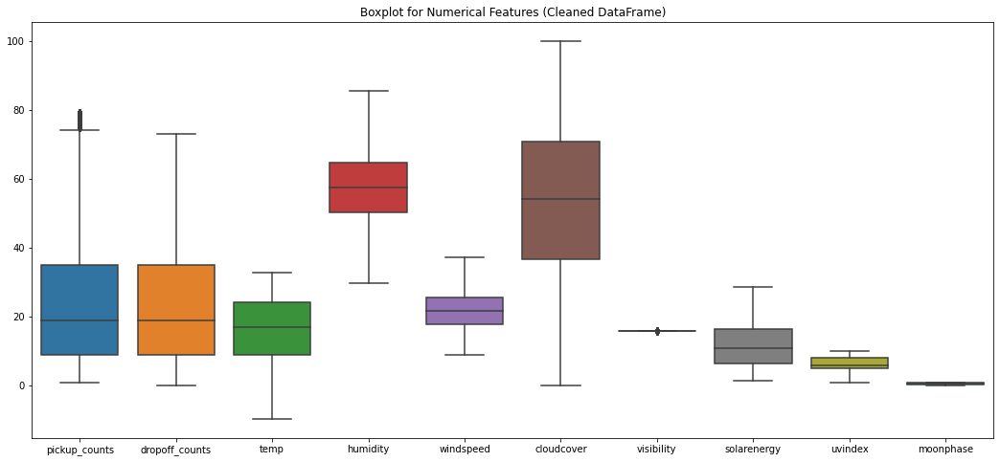

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Convert cleanedDF (PySpark DataFrame) to Pandas DataFrame
cleaned_df_pandas = cleanedDF.toPandas()

# Boxplot for all numerical columns in the cleaned dataframe
plt.figure(figsize=(18, 8))

sns.boxplot(
    data=cleaned_df_pandas[[
        "pickup_counts", "dropoff_counts", "temp", "humidity", "windspeed", "cloudcover", "visibility", 
        "solarenergy", "uvindex", "moonphase"
    ]]
)

plt.title("Boxplot for Numerical Features (Cleaned DataFrame)")
plt.show()



**Multivariate Analysis**

In [0]:
# Computing pairwise correlations

numeric_columns = ["pickup_counts", "dropoff_counts",  "temp",  "humidity", "windspeed","cloudcover", "visibility", "solarenergy", "uvindex", "moonphase"]

corr_matrix = cleaned_df_pandas[numeric_columns].corr()

print(corr_matrix)


                pickup_counts  dropoff_counts      temp  humidity  windspeed  \
pickup_counts        1.000000        0.938538  0.122148  0.023488  -0.025906   
dropoff_counts       0.938538        1.000000  0.117473  0.022588  -0.024457   
temp                 0.122148        0.117473  1.000000  0.338244  -0.084731   
humidity             0.023488        0.022588  0.338244  1.000000  -0.363961   
windspeed           -0.025906       -0.024457 -0.084731 -0.363961   1.000000   
cloudcover          -0.002988       -0.002885  0.068267  0.327648   0.008441   
visibility          -0.014631       -0.014198 -0.133363 -0.211844   0.104118   
solarenergy          0.096299        0.094025  0.277093 -0.265120   0.075217   
uvindex              0.116708        0.113484  0.375199 -0.272895   0.071776   
moonphase           -0.008928       -0.008807 -0.026169 -0.044750   0.027502   

                cloudcover  visibility  solarenergy   uvindex  moonphase  
pickup_counts    -0.002988   -0.014631     0

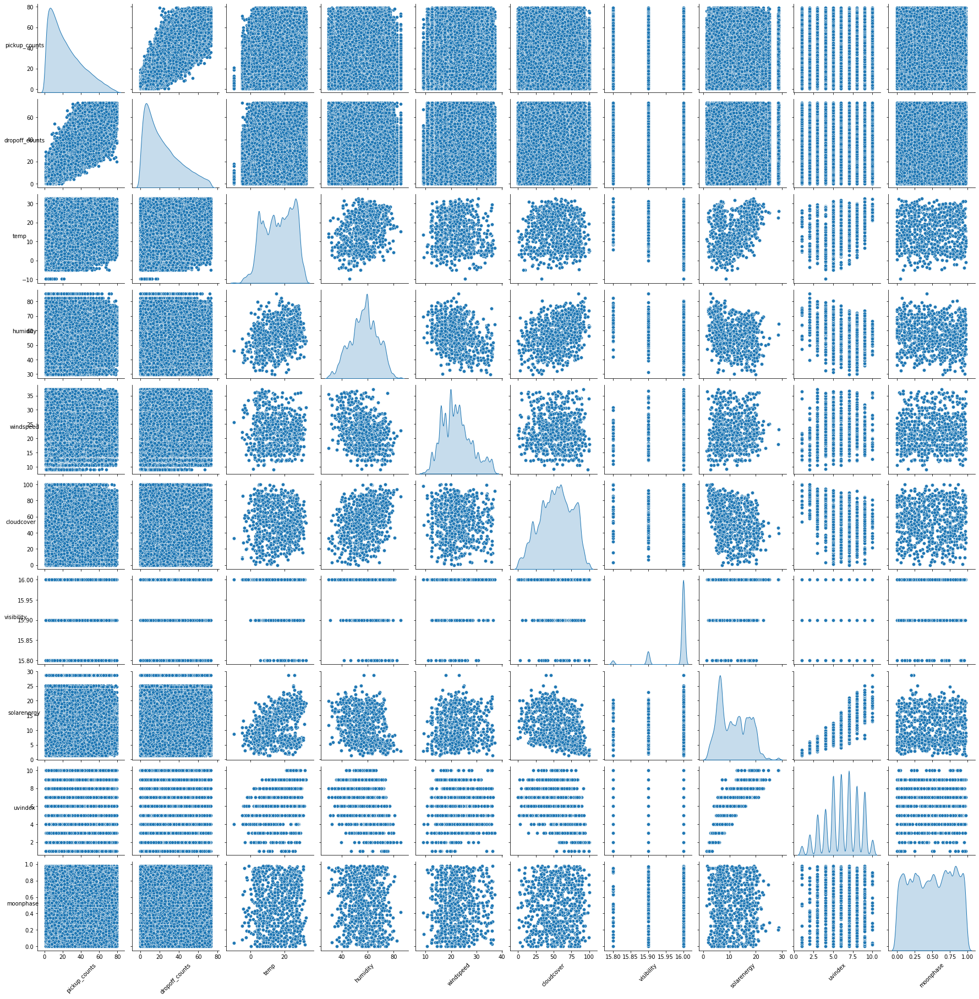

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the pairplot
g = sns.pairplot(
    cleaned_df_pandas[[
        "pickup_counts", "dropoff_counts", "temp", "humidity",  "windspeed", "cloudcover", "visibility", 
        "solarenergy", "uvindex", "moonphase"
    ]],
    diag_kind="kde"
)

# Set axis labels for each subplot
for ax in g.axes.flat:  # Iterate through each subplot
    ax.set_xlabel(ax.get_xlabel(), fontsize=10)
    ax.set_ylabel(ax.get_ylabel(), fontsize=10)
    ax.xaxis.label.set_rotation(45)  # Rotate x-axis labels for better readability
    ax.yaxis.label.set_rotation(0)   # Keep y-axis labels horizontal

# Show the plot
plt.show()


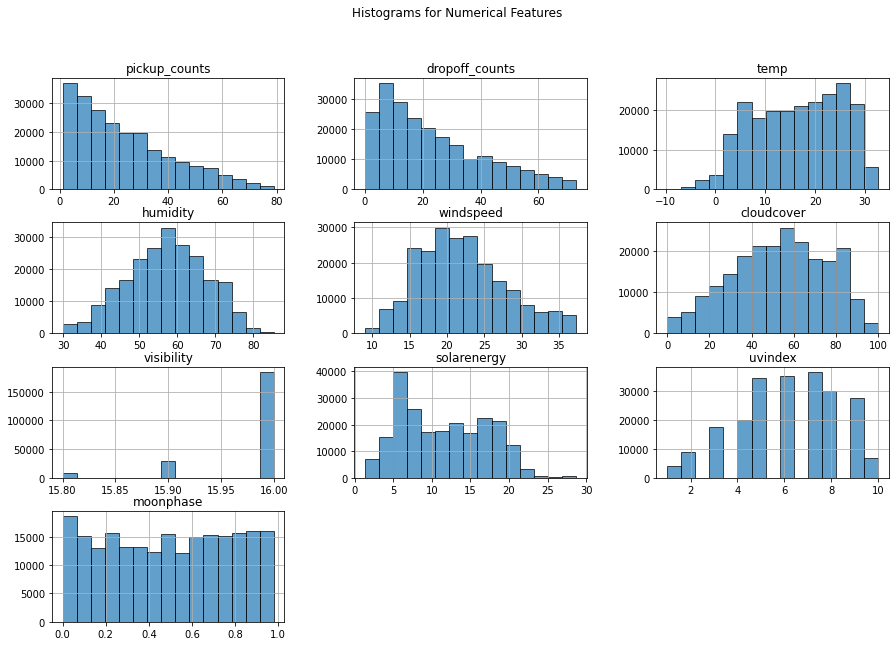

In [0]:
# Histogram for all columns
cleaned_df_pandas[numeric_columns].hist(bins=15, figsize=(15, 10), alpha=0.7, edgecolor='k')
plt.suptitle("Histograms for Numerical Features")
plt.show()


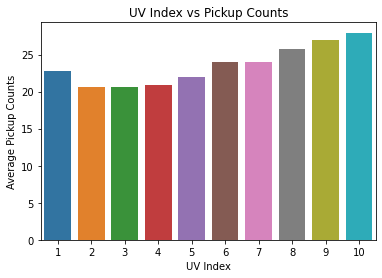

In [0]:
# Import required libraries
import seaborn as sns
import matplotlib.pyplot as plt

# Group data by uvindex
df_grouped = cleaned_df_pandas.groupby("uvindex")["pickup_counts"].mean().reset_index()

# Bar plot
sns.barplot(data=df_grouped, x="uvindex", y="pickup_counts")
plt.title("UV Index vs Pickup Counts")
plt.xlabel("UV Index")
plt.ylabel("Average Pickup Counts")
plt.show()


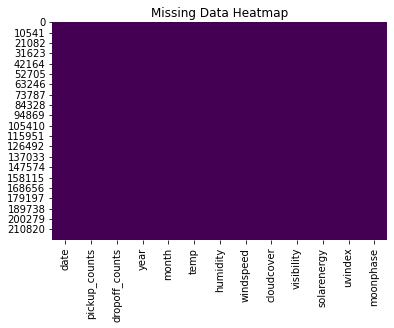

In [0]:
# Visualizing missing values using seaborn heatmap

sns.heatmap(cleaned_df_pandas.isnull(), cbar=False, cmap="viridis")
plt.title("Missing Data Heatmap")
plt.show()

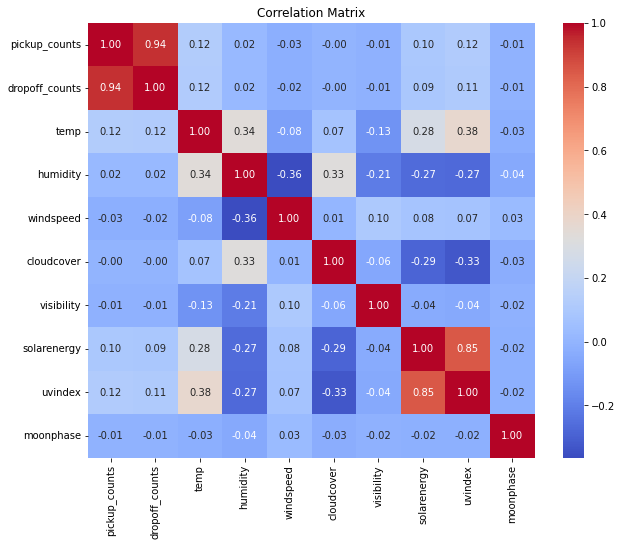

In [0]:
# Heatmap for correlations

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()



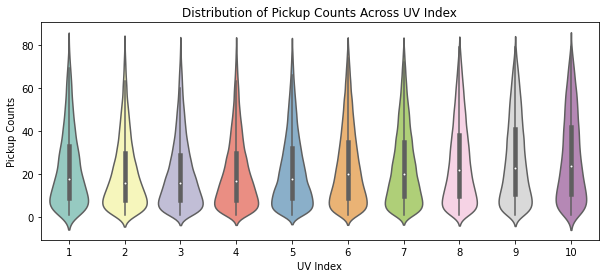

In [0]:
# Violin plot for pickup counts with respect to UV index
plt.figure(figsize=(10, 4))
sns.violinplot(x="uvindex", y="pickup_counts", data=cleaned_df_pandas, palette="Set3")
plt.title("Distribution of Pickup Counts Across UV Index")
plt.xlabel("UV Index")
plt.ylabel("Pickup Counts")
plt.show()


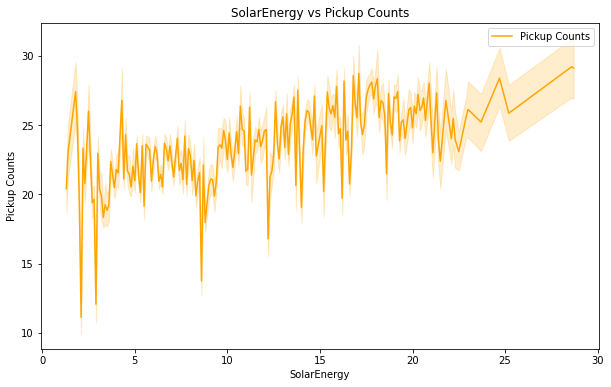

In [0]:
# Line plot for Visibility vs pickup counts
plt.figure(figsize=(10, 6))
sns.lineplot(data=cleaned_df_pandas, x= "solarenergy", y="pickup_counts", color="orange", label="Pickup Counts")
plt.title("SolarEnergy vs Pickup Counts")
plt.xlabel("SolarEnergy")
plt.ylabel("Pickup Counts")
plt.legend()
plt.show()


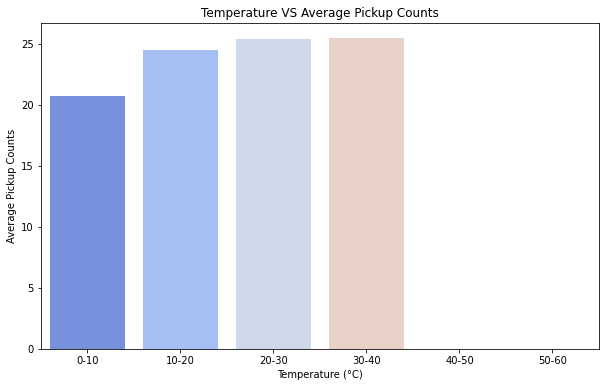

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Converting the 'temp' column to categorical bins (e.g., 0-10, 10-20, etc.)
bin_labels = ["0-10", "10-20", "20-30", "30-40", "40-50", "50-60"]
cleaned_df_pandas["temp_bins"] = pd.cut(
    cleaned_df_pandas["temp"],
    bins=[0, 10, 20, 30, 40, 50, 60],  # Bin edges
    labels=bin_labels,  # Bin labels
    include_lowest=True  # Include the lower edge in the first bin
)

# Grouping the data by 'temp_bins' and calculate the average 'pickup_counts' for each bin
temp_grouped = cleaned_df_pandas.groupby("temp_bins")["pickup_counts"].mean().reset_index()

# Creating a bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=temp_grouped, x="temp_bins", y="pickup_counts", palette="coolwarm")

# Adding titles and labels
plt.title("Temperature VS Average Pickup Counts")
plt.xlabel("Temperature (°C)")
plt.ylabel("Average Pickup Counts")

plt.show()


In [0]:
# Displaying the dataset and visualize pickup counts

display(df_merged.select("pickup_counts", "dropoff_counts",  "temp",  "humidity", "precip",  "precipprob",  "snow",  "windspeed","cloudcover", "visibility", "solarenergy", "uvindex", "moonphase"))

pickup_counts,dropoff_counts,temp,humidity,precip,precipprob,snow,windspeed,cloudcover,visibility,solarenergy,uvindex,moonphase
1,2.0,14.9,69.6,2.607,100,0.0,25.7,66.7,16.0,9.5,6,0.3
140,147.0,16.3,54.0,0.0,0,0.0,26.1,30.2,15.9,14.0,9,0.33
5,3.0,18.6,72.5,10.234,100,0.0,21.4,71.7,15.2,5.7,4,0.37
6,9.0,18.6,72.5,10.234,100,0.0,21.4,71.7,15.2,5.7,4,0.37
8,13.0,18.6,72.5,10.234,100,0.0,21.4,71.7,15.2,5.7,4,0.37
17,19.0,19.2,53.8,15.555,100,0.0,44.9,50.3,15.2,13.3,8,0.4
2,1.0,19.2,53.8,15.555,100,0.0,44.9,50.3,15.2,13.3,8,0.4
3,1.0,19.2,53.8,15.555,100,0.0,44.9,50.3,15.2,13.3,8,0.4
3,3.0,12.3,55.6,4.488,100,0.0,24.0,81.0,15.2,5.0,2,0.44
1,1.0,11.2,80.9,1.657,100,0.0,27.0,79.1,13.4,4.0,2,0.47
